# Investigating autoencoders

Autoencoders are neural networks with matching input and output layers and at least one hidden layer with a smaller dimensionality than the input and output. The idea is the layer acts as a funnel for dimensionality.

We want to investigate that here.

## Step One: Wrangle Data

We're aiming to get the shape of (trials, dim of trial)

In [3]:
from data import get_spikes_data, data_dir

In [4]:
spikes, _ = get_spikes_data(data_dir, tetrode_id=1)

FileNotFoundError: [Errno 2] No such file or directory: b'/run/media/trevortknguyen/a8a15e97-b12c-4825-8482-0be8f89aac96/remy_from_eric/remy_35_02_marks.nc'

We reserve some of the points as testing.

In [24]:
n_test = 10000
x_train, x_test = spikes[n_test:], spikes[:n_test]
print(x_test.shape)
print(x_train.shape)

(10000, 4)
(52003, 4)


## Step Two: Prepare Data with PyTorch

In [28]:
import torch

dtype = torch.float
device = torch.device("cpu")

In [29]:
x = torch.from_numpy(x_train)

In [112]:
print(x_train.dtype)

float32


## Step Three: Set up model

In [31]:
D_in = D_out = 4
H = 3

In [32]:
class Autoencoder(torch.nn.Module):
    def __init__(self, D_in, H, D_out):
        super(Autoencoder, self).__init__()
        self.fc1 = torch.nn.Linear(D_in, H)
        self.fc2 = torch.nn.LeakyReLU()
        self.fc3 = torch.nn.Linear(H, D_out)
        
    def forward(self, x):
        x = self.fc1(x)
        x = self.fc2(x)
        x = self.fc3(x)
        return x

    def dim_reduce(self, x):
        with torch.no_grad():
            x = self.fc1(x)
            return x


In [34]:
def create_model(D_in, H, D_out, model='sequential'):
    if model == 'sequential':
        return torch.nn.Sequential(
            torch.nn.Linear(D_in, H),
            torch.nn.ReLU(),
            torch.nn.Linear(H, D_out),
        )
    elif model == 'custom':
        return Autoencoder(D_in, H, D_out)

In [36]:
model = create_model(D_in, H, D_out, model='custom')

In [113]:
from math import ceil
loss_fn = torch.nn.MSELoss()

In [40]:
learning_rate = 1e-4
optimizer = torch.optim.Adam(model.parameters(), lr=learning_rate)

epochs = 50
batch_size = 512

examples, _ = x.shape

for e in range(epochs):
    for t in range(ceil(examples/batch_size)):
        x_slice = x[t * batch_size : (t+1) * batch_size]

        y_pred = model(x_slice)

        loss = loss_fn(y_pred, x_slice)
        if t % 100 == 99:
            print(t, loss.item())

        optimizer.zero_grad()

        loss.backward()

        optimizer.step()

99 18039.05078125
99 17501.958984375
99 16822.8828125
99 15962.89453125
99 15024.0810546875
99 14051.81640625
99 13074.0625
99 12113.9072265625
99 11189.6923828125
99 10314.2783203125
99 9494.5498046875
99 8731.4951171875
99 8021.03466796875
99 7355.67626953125
99 6726.97607421875
99 6128.11083984375
99 5555.46240234375
99 5008.59765625
99 4489.1943359375
99 3999.804443359375
99 3542.951416015625
99 3120.60205078125
99 2733.905517578125
99 2383.091064453125
99 2067.51171875
99 1785.771240234375
99 1535.9400634765625
99 1315.790771484375
99 1123.0111083984375
99 955.3696899414062
99 810.7952880859375
99 687.37548828125
99 583.3157348632812
99 496.86431884765625
99 426.2589416503906
99 369.7006530761719
99 325.3529052734375
99 291.3822021484375
99 266.0036926269531
99 247.54171752929688
99 234.4799041748047
99 225.4956512451172
99 219.4850311279297
99 215.56100463867188
99 213.04129028320312
99 211.4227752685547
99 210.3500213623047
99 209.58331298828125
99 208.96881103515625
99 208.4133

In [41]:
x_validate = torch.from_numpy(x_test)

In [42]:
model(x_validate)

tensor([[110.7504, 151.9426, 108.8076,  89.9602],
        [108.4007, 139.2595,  95.5388,  73.7135],
        [ 84.1208, 116.5493,  83.7706,  70.5249],
        ...,
        [228.0742, 313.3823, 224.8141, 185.7403],
        [140.1984, 182.2130, 125.2974, 100.4723],
        [122.3396, 161.7194, 114.3634,  86.7475]], grad_fn=<AddmmBackward>)

## Step 4: Try to do an estimation
We're going to use a product kernel because that's easiest.

In [114]:
from functools import partial

def gaussian_univariate_kernel(b, x):
    '''
    x is the distance
    b is the bandwidth
    '''
    c = (2*np.pi)**(-0.5)
    return c * np.exp(-0.5*(x/b)**2)


In [45]:
def product_kernel(h, x):
    '''
    h is a d-dimensional vector of smoothing parameters for each dimension
    x is a single d-dimensional vector representing the distance
    '''
    c = 1/np.prod(h)
    v = gaussian_univariate_kernel(h, x)
    return c * np.prod(v, axis=-1)

In [46]:
def product_kernel_estimation(h, xs, x):
    return np.mean(product_kernel(h, xs-x))

Actual evaluation time

In [26]:
import plotly.express as px

In [27]:
smoothings = np.array([150, 150, 150])

In [28]:
K = partial(product_kernel_estimation, smoothings, xs)
px.scatter_3d(x=xs[:, 0], y=xs[:, 1], z=xs[:,2], color=[K(x) for x in xs])

Looking at the original data compared to the not original data.

In [47]:
before = x_train
after = model(torch.from_numpy(x_train)).detach().numpy()
print(before.shape)
print(after.shape)

(52003, 4)
(52003, 4)


In [48]:
px.scatter_3d(x=before[:, 0], y=before[:, 1], z=before[:,2], color=before[:,3])

In [49]:
px.scatter_3d(x=after[:, 0], y=after[:, 1], z=after[:,2], color=before[:,3])

## Step 5: Look at the distribution of amplitudes?

Maybe scale these up or something?

In [51]:
import pandas as pd

def make_histogram_df(xs):
    df = pd.DataFrame({
        'spikes': np.concatenate([
            xs[:, 0],
            xs[:, 1],
            xs[:, 2],
            xs[:, 3],

        ]),
        'electrode': np.repeat(['a','b','c','d'], xs.shape[0])
    })
    return df

Assuming a homogenous distribution of neurons around each probe, we expect more neurons to be farther away from the tetrode because the volume contained in a $\mathrm{d}r$ region is larger at larger radii. So the expected number of neurons at such a distance is proportional to the volume at that distance.

At the same time, the detected amplitude at a distance of r should be proportional to $\frac{I}{r}$. So discounting for bursting pyramidal cells, which are known to have smaller peak amplitudes as they continue bursting, the distance of a neuron is approximately proportional to $\frac{1}{a}$ where $a$ is the amplitude.

$number of neurons \propto r^2$

$number of neurons \propto \frac{1}{a^2}$

Why is it bimodal? I feel like someone might have an answer for this, but it's something that sticks out to me regardless.

Thought. What if we scaled up spikes that were far away so they could be "heard" better. It's kind of like bringing the neurons closer. At that point can you even justify doing this? Simply multiplying should be fine if it's like a point sort of thing.

If you're half as loud as the max amplitude, that means you're twice as far away, meaning you should be increased.

## Step 6: Understanding PCA
Going to:
- scale with StandardScaler, then PCA transform
- scale with custom scaling scheme, then PCA transform
- scale with identity, then PCA transform

In [85]:
from sklearn.preprocessing import StandardScaler

def scale_identity(spikes):
    return spikes

def scale_standard_scaler(spikes):
    return StandardScaler().fit_transform(spikes)

def scale_custom(spikes):
    '''
    Scales the spikes by dividing 
    '''
    tetrode_means = np.mean(spikes, axis=1)

    broadcasted_means = np.empty(spikes.shape)
    broadcasted_means[:,0] = tetrode_means
    broadcasted_means[:,1] = tetrode_means
    broadcasted_means[:,2] = tetrode_means
    broadcasted_means[:,3] = tetrode_means
    
    return spikes / broadcasted_means


### Testing different types of scalings

In [58]:
x = spikes[:10000]

In [59]:
scaled = scale_identity(x)
px.histogram(make_histogram_df(scaled), x='spikes', facet_col='electrode',
                   marginal="violin")

In [60]:
scaled = scale_standard_scaler(x)
px.histogram(make_histogram_df(scaled), x='spikes', facet_col='electrode',
                   marginal="violin")

In [61]:
scaled = scale_custom(x)
px.histogram(make_histogram_df(scaled), x='spikes', facet_col='electrode',
                   marginal="violin")

Now check out the PCA stuff.

In [62]:
from sklearn.decomposition import PCA

In [92]:
def pca_transform(scaled_spikes):
    pca = PCA(n_components=3)
    return pca.fit_transform(scaled_spikes)

In [168]:
principalComponents = pca_transform(spikes)

In [66]:
principalComponents

array([[-88.886856 ,  32.802807 ,   3.0802088],
       [-75.29929  ,  32.29842  ,   1.795034 ],
       [-70.88533  ,  29.28651  ,  -2.317648 ],
       ...,
       [-69.72158  ,  26.161232 , -11.934625 ],
       [-41.804096 , -33.652855 ,   2.3546336],
       [ 22.569845 ,  29.84763  ,  -2.9501245]], dtype=float32)

In [137]:
smoothings = np.array([1, 1, 1])
xs = principalComponents
xs = xs[xs[:,1] < 1]
K = partial(product_kernel_estimation, smoothings, xs)
px.scatter_3d(x=xs[:, 0], y=xs[:, 1], z=xs[:,2], color=[K(x) for x in xs])

In [71]:
import seaborn as sns

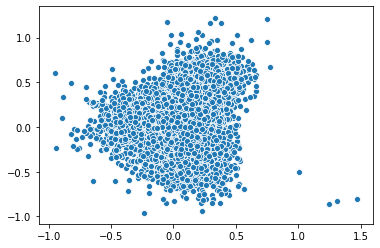

In [153]:
xs = principalComponents

sns.scatterplot(data={
    'x': xs[:,1],
    'y': xs[:,0],
}, x='x', y='y')

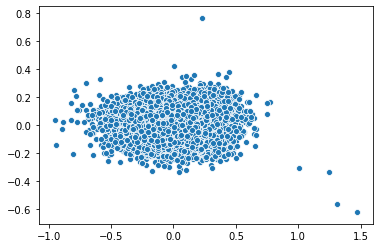

In [154]:
xs = principalComponents

sns.scatterplot(data={
    'x': xs[:,1],
    'y': xs[:,2],
}, x='x', y='y')

## Step 7: Now test these things to see if they're good.
You want to decode.

> Chen, Z., Kloosterman, F., Layton, S., & Wilson, M. A. (2012, August). Transductive neural decoding for unsorted neuronal spikes of rat hippocampus. In 2012 Annual International Conference of the IEEE Engineering in Medicine and Biology Society (pp. 1310-1313). IEEE.

We can start with a time-homogeneous model as used in this 2012 paper. The limitations are that it doesn't adapt to changes like a state-space model would. But this should be okay, right?

We estimate rate functions initially.

When we estimate the joint pdf of two different multi-dimensional variables (d-dimensional marks and q-dimensional states), we can do a product kernel of all of them. Alternatively, if we're doing a bandwidth-based kernel, then our actual kernel can be the product of the two bandwidth-based kernels.



In [103]:
def transform_spikes_to_marks(spikes):
    scaled_spikes = scale_custom(spikes)
    marks = pca_transform(scaled_spikes)

    assert marks.shape[0] == spikes.shape[0]
    return marks
    
def get_marks_data(data_dir, animal_id = 'remy_35_02', tetrode_id = 1):
    spikes, states = get_spikes_data(data_dir, animal_id, tetrode_id)
    marks = transform_spikes_to_marks(spikes)
    assert marks.shape[0] == states.shape[0]
    return marks, states


In [109]:
# let N be our number of spikes
# let d be the dimensionality of our marks and q be the dimensionality of our state
# get our marks as an nd-array (N, d)
# get our state as an nd-array (N, q)

marks, states = get_marks_data(data_dir, tetrode_id=3)
print(marks.shape)
print(states.shape)

/nix/store/szq765zmfb53003hfxw7rb082nr70ch5-python3-3.7.6-env/lib/python3.7/site-packages/IPython/core/interactiveshell.py:3331: DtypeWarning:

Columns (11,12,13,15) have mixed types.Specify dtype option on import or set low_memory=False.



(79551, 3)
(79551, 1)


### Estimating just the pdf of state

In [193]:
smoothings = np.array([1])
K = partial(product_kernel_estimation, smoothings, states)

x_range = np.linspace(5, 350, 300)
x_vals = x_range.reshape(x_range.shape[0], 1)
y_vals = [K(x) for x in x_vals]

Estimation of the state p(x).

In [194]:
px.scatter(x=x_range, y=y_vals)

### Estimating just the joint pdf of marks and state

In [207]:
def evaluate_bivariate_multidimensional_product(mark_data, state_data, smoothings_mark, smoothings_state, a, x):
    '''
    a is the mark
    x is the state
    
    sum this.
    '''
    assert mark_data.shape[1] == a.shape[0]
    assert state_data.shape[1] == x.shape[0]
    
    d_marks = mark_data - a
    d_states = state_data - x
    
    assert d_marks.shape == mark_data.shape
    assert d_states.shape == state_data.shape

    marks_product = product_kernel(smoothings_mark, d_marks)
    states_product = product_kernel(smoothings_state, d_states)
    marks_states_product = marks_product * states_product

    return np.mean(marks_states_product)
    

In [208]:
evaluate_bivariate_multidimensional_product(marks,
                                            states,
                                            np.array([1, 1, 1]), # bandwidths
                                            np.array([1]),
                                            np.array([0, 0, 0]), # point
                                            np.array([0]),
                                           )

0.004948746061635096

## Step 8: Try to visualize how this function is working.

In [ ]:
x = np.array([0])

marks = 

## Step 9: Now test these things to see if they're good.


In [212]:
p = partial(evaluate_bivariate_multidimensional_product,
            marks,
            states,
            np.array([1, 1, 1]), # bandwidths
            np.array([1]),
           )
pi = partial(product_kernel_estimation,
             smoothings,
             states)

In [222]:
def generalized_rate_function(total_time, marks, states, a, x):
    p = partial(evaluate_bivariate_multidimensional_product,
                marks,
                states,
                np.array([1, 1, 1]), # bandwidths
                np.array([1]),
               )
    pi = partial(product_kernel_estimation,
                 smoothings,
                 states
                )
    
    # spikes / time = mean spiking rate
    n_spikes = spikes.shape[0]
    time = total_time # correct this, it's fixed in 20 minutes
    
    return n_spikes / time * p(a, x) / pi(x)
    

In [219]:
# this likely needs fixing
def marginalized_rate_function(x):
    pi = partial(product_kernel_estimation,
                 smoothings,
                 states
                )
    pass

In [223]:
def x_given_a_part(total_time, dt, marks, states, a, x):
    lax = partial(generalized_rate_function, total_time, marks, states)
    l = partial(marginalized_rate_function)
    
    lax(a, x) * np.exp(-dt * l(x)) * P(x)

In [215]:
p(np.array([0, 0, 0]),np.array([0]))

0.004948746061635096

In [217]:
pi(np.array([0]))

0.08577341669654502